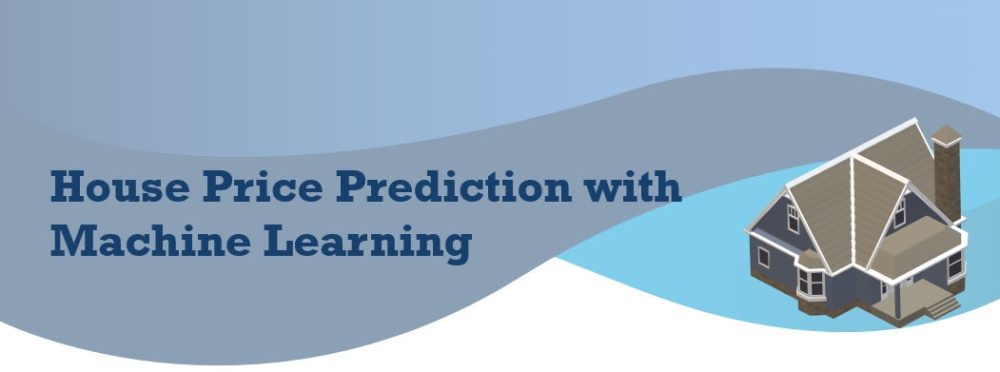

<a id="toc"></a>

<h3 class="list-group-item list-group-item-action active" data-toggle="list" role="tab" aria-controls="home">Table of Contents</h3>
    
* [1. Introduction](#0) 

* [2. Explatory Data Analysis](#0) 
    * [2.1 Feature Enginnering](#0) 
    * [2.2 Correlation Analysis](#0) 
    * [2.3 Producing New Columns for Feature Engineering](#0) 
    * [2.4 Feature Extractions](#0) 
    * [2.5 Outliers](#0) 
    * [2.6 Missing Values](#0) 
    * [2.7 Label Encoding](#0) 
    * [2.8 Rare Encoding](#0) 
    * [2.9 One-Hot Encoding](#0) 
        
* [3. Machine Learning Model](#0) 
    * [3.1 Standart Scaler](#0) 
    * [3.2 Modeling](#0) 
    * [3.3 Hyper Parameters Tunning](#0)

* [4. Conclusions](#0) 
* [5. References](#0) 


In [103]:
# Basic Libraries
import numpy as np
import pandas as pd
from warnings import filterwarnings
from collections import Counter

import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

pd.set_option('display.max_columns', None)
pd.set_option('display.max_colwidth', 100)
pd.set_option('display.max_rows', 50)
pd.set_option('display.width', 5000)
pd.set_option('display.expand_frame_repr', False)
pd.set_option('display.float_format', lambda x: '%.4f' % x)

# Visualizations Libraries
import matplotlib.pyplot as plt
from matplotlib.pyplot import figure
import seaborn as sns
import plotly
import plotly.offline as pyo
import plotly.express as px
import plotly.graph_objs as go
pyo.init_notebook_mode()
import plotly.figure_factory as ff
import missingno as msno

# Generating Random Floating Point Values
from numpy.random import seed
import random
from random import randrange

# System Operations
import sys
import os

pd.options.mode.chained_assignment = None

# Data Pre-processing Libraries
from sklearn.preprocessing import StandardScaler,MinMaxScaler, LabelEncoder
from sklearn.model_selection import train_test_split

# Modelling Libraries
from sklearn.linear_model import LogisticRegression,RidgeClassifier,SGDClassifier,PassiveAggressiveClassifier
from sklearn.linear_model import Perceptron
from sklearn.svm import SVC,LinearSVC,NuSVC
from sklearn.neighbors import KNeighborsClassifier,NearestCentroid
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier,AdaBoostClassifier,GradientBoostingClassifier, RandomForestRegressor,\
GradientBoostingRegressor, VotingRegressor, AdaBoostRegressor, BaggingRegressor, ExtraTreesRegressor, StackingRegressor
from sklearn.naive_bayes import GaussianNB,BernoulliNB
from sklearn.ensemble import VotingClassifier
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, \
    roc_auc_score, confusion_matrix, classification_report, plot_roc_curve
from sklearn.ensemble import HistGradientBoostingRegressor
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV, cross_val_score, cross_validate, train_test_split

from xgboost import XGBClassifier, XGBRegressor
from lightgbm import LGBMClassifier, LGBMRegressor
from catboost import CatBoostRegressor

from sklearn.neighbors import LocalOutlierFactor
from sklearn.linear_model import LinearRegression, Ridge, Lasso, ElasticNet
from sklearn.neighbors import KNeighborsRegressor
from sklearn.svm import SVR
from sklearn.tree import DecisionTreeRegressor
from sklearn.experimental import enable_hist_gradient_boosting
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor, VotingRegressor, \
    AdaBoostRegressor, BaggingRegressor, ExtraTreesRegressor, HistGradientBoostingRegressor, StackingRegressor
from sklearn.preprocessing import RobustScaler, MinMaxScaler, LabelEncoder, StandardScaler
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV, cross_val_score, cross_validate, train_test_split
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
import time

# Evaluation & CV Libraries
from sklearn.metrics import precision_score,accuracy_score
from sklearn.model_selection import RandomizedSearchCV,GridSearchCV,RepeatedStratifiedKFold

<h1 class="list-group-item list-group-item-action active" data-toggle="list" role="tab" aria-controls="home">1. Introduction</h1>

Accurately estimating the financial value of real estate is important to many people, including homeowners, home buyers, agents, creditors and investors. While it is common knowledge that factors such as size, number of rooms and location affect the price, there are also many other parameters that affect the price. In addition, prices can be other parameters that affect the price, such as changes in market demand and the urgent need to sell a property. 
    
    
* Problem
    
It is desired to carry out a machine learning project regarding the prices of different types of houses by using the data set containing the features and house prices of each house.

* Feature Description

With 79 explanatory variables describing (almost) every aspect of residential homes in Ames, Iowa, this competition challenges you to predict the final price of each home.

* Variables

The Train dataset consists of 1460 observations and 81 variables, and the Test dataset consists of 1459 observation units.

* Purpose

House prices are left null in the test dataset, and you are expected to estimate these values. Carrying out a machine learning project that predicts house prices with minimum error on the data set we have.


<h1 class="list-group-item list-group-item-action active" data-toggle="list" role="tab" aria-controls="home">2. Explatory Data Analysis</h1>

* The data used in the experiment will be processed using a combination of preprocessing methods to improve the prediction accuracy. Also, some factors will be added to the local dataset to examine the relationship between these factors and the selling price in Iowa.

In [104]:
def load_house():
    global train, test, df
    train = pd.read_csv('train.csv')
    test = pd.read_csv('test.csv')
    df = train.append(test).reset_index(drop=True)

In [105]:
load_house()

In [106]:
df.head()

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,1,60,RL,65.0000,8450,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2003,2003,Gable,CompShg,VinylSd,VinylSd,BrkFace,196.0000,Gd,TA,PConc,Gd,TA,No,GLQ,706.0000,Unf,0.0000,150.0000,856.0000,GasA,Ex,Y,SBrkr,856,854,0,1710,1.0000,0.0000,2,1,3,1,Gd,8,Typ,0,NaN,Attchd,2003.0000,RFn,2.0000,548.0000,TA,TA,Y,0,61,0,0,0,0,NaN,NaN,NaN,0,2,2008,WD,Normal,208500.0000
1,2,20,RL,80.0000,9600,Pave,NaN,Reg,Lvl,AllPub,FR2,Gtl,Veenker,Feedr,Norm,1Fam,1Story,6,8,1976,1976,Gable,CompShg,MetalSd,MetalSd,None,0.0000,TA,TA,CBlock,Gd,TA,Gd,ALQ,978.0000,Unf,0.0000,284.0000,1262.0000,GasA,Ex,Y,SBrkr,1262,0,0,1262,0.0000,1.0000,2,0,3,1,TA,6,Typ,1,TA,Attchd,1976.0000,RFn,2.0000,460.0000,TA,TA,Y,298,0,0,0,0,0,NaN,NaN,NaN,0,5,2007,WD,Normal,181500.0000
2,3,60,RL,68.0000,11250,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2001,2002,Gable,CompShg,VinylSd,VinylSd,BrkFace,162.0000,Gd,TA,PConc,Gd,TA,Mn,GLQ,486.0000,Unf,0.0000,434.0000,920.0000,GasA,Ex,Y,SBrkr,920,866,0,1786,1.0000,0.0000,2,1,3,1,Gd,6,Typ,1,TA,Attchd,2001.0000,RFn,2.0000,608.0000,TA,TA,Y,0,42,0,0,0,0,NaN,NaN,NaN,0,9,2008,WD,Normal,223500.0000
3,4,70,RL,60.0000,9550,Pave,NaN,IR1,Lvl,AllPub,Corner,Gtl,Crawfor,Norm,Norm,1Fam,2Story,7,5,1915,1970,Gable,CompShg,Wd Sdng,Wd Shng,None,0.0000,TA,TA,BrkTil,TA,Gd,No,ALQ,216.0000,Unf,0.0000,540.0000,756.0000,GasA,Gd,Y,SBrkr,961,756,0,1717,1.0000,0.0000,1,0,3,1,Gd,7,Typ,1,Gd,Detchd,1998.0000,Unf,3.0000,642.0000,TA,TA,Y,0,35,272,0,0,0,NaN,NaN,NaN,0,2,2006,WD,Abnorml,140000.0000
4,5,60,RL,84.0000,14260,Pave,NaN,IR1,Lvl,AllPub,FR2,Gtl,NoRidge,Norm,Norm,1Fam,2Story,8,5,2000,2000,Gable,CompShg,VinylSd,VinylSd,BrkFace,350.0000,Gd,TA,PConc,Gd,TA,Av,GLQ,655.0000,Unf,0.0000,490.0000,1145.0000,GasA,Ex,Y,SBrkr,1145,1053,0,2198,1.0000,0.0000,2,1,4,1,Gd,9,Typ,1,TA,Attchd,2000.0000,RFn,3.0000,836.0000,TA,TA,Y,192,84,0,0,0,0,NaN,NaN,NaN,0,12,2008,WD,Normal,250000.0000


In [107]:
def check_df(dataframe, head=5):
    
    print("##################### Shape #####################")
    print(dataframe.shape)
    
    print("##################### Types #####################")
    print(dataframe.dtypes)
    
    print("##################### NA #####################")
    print(dataframe.isnull().sum())
    
    print("##################### Quantiles #####################")
    print(dataframe.quantile([0, 0.05, 0.50, 0.95, 0.99, 1]).T)

In [108]:
check_df(df)

##################### Shape #####################
(2919, 81)
##################### Types #####################
Id                 int64
MSSubClass         int64
MSZoning          object
LotFrontage      float64
LotArea            int64
                  ...   
MoSold             int64
YrSold             int64
SaleType          object
SaleCondition     object
SalePrice        float64
Length: 81, dtype: object
##################### NA #####################
Id                  0
MSSubClass          0
MSZoning            4
LotFrontage       486
LotArea             0
                 ... 
MoSold              0
YrSold              0
SaleType            1
SaleCondition       0
SalePrice        1459
Length: 81, dtype: int64
##################### Quantiles #####################
                  0.0000     0.0500      0.5000      0.9500      0.9900      1.0000
Id                1.0000   146.9000   1460.0000   2773.1000   2889.8200   2919.0000
MSSubClass       20.0000    20.0000     50.0000    1

<h4 class="list-group-item list-group-item-action active" data-toggle="list" role="tab" aria-controls="home">2.1. Feature Enginnering</h4>

* Any observations which had missing values were also removed from the dataset. Below are a few feature engineering processes which were done  to cleanse the dataset:


* [1. Proximity to main road or railway](#0)   
* [2. Proximity to the main road or railway (if a second location is available)](#1)
* [3. Housing type](#2)
* [4. Housing style](#3)
* [5. Roof type](#4)
* [6. Roofing material](#5)
* [7. Exterior cladding in the house (if there is more than one material)](#6)
* [8. Institution type](#7)
* [9. Total Number of Floors](#7)
* [10. 1st floor and basement](#7)
* [11. Garage area and sum of square meters](#7)
* [12. Total Patio Area](#7)
* [13. Houses With Pool](#7)
* [14. Luxurious Houses](#7)

In [109]:
def grab_col_names(dataframe, cat_th=10, car_th=20, excluded=None):

    excluded = [] if excluded is None else excluded
    df_cols  = [i for i in dataframe.columns if i not in excluded]

    # cat_cols, cat_but_car
    cat_cols = [col for col in df_cols if dataframe[col].dtypes == "O"]
    num_but_cat = [col for col in df_cols if dataframe[col].nunique() < cat_th and
                   dataframe[col].dtypes != "O"]
    cat_but_car = [col for col in df_cols if dataframe[col].nunique() > car_th and
                   dataframe[col].dtypes == "O"]
    cat_cols = cat_cols + num_but_cat
    cat_cols = [col for col in cat_cols if col not in cat_but_car]

    # num_cols
    num_cols = [col for col in df_cols if dataframe[col].dtypes != "O"]
    num_cols = [col for col in num_cols if col not in num_but_cat]

    print(f"Observations: {dataframe.shape[0]}")
    print(f"Variables: {dataframe.shape[1]}")
    print(f'cat_cols: {len(cat_cols)}')
    print(f'num_cols: {len(num_cols)}')
    print(f'cat_but_car: {len(cat_but_car)}')
    print(f'num_but_cat: {len(num_but_cat)}')
    return cat_cols, num_cols, cat_but_car, num_but_cat

In [110]:
cat_cols, num_cols, cat_but_car, num_but_cat = grab_col_names(df)

dfx = df.copy()
dfx['SalePrice'] = pd.qcut(dfx['SalePrice'], 3, ['low', 'mid', 'high'])


Observations: 2919
Variables: 81
cat_cols: 52
num_cols: 28
cat_but_car: 1
num_but_cat: 10


Observations: 2919
Variables: 81
cat_cols: 52
num_cols: 28
cat_but_car: 1
num_but_cat: 10


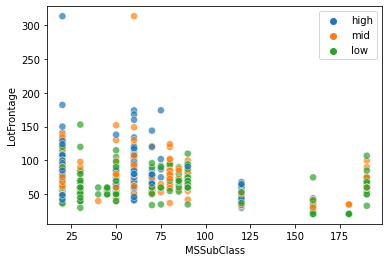

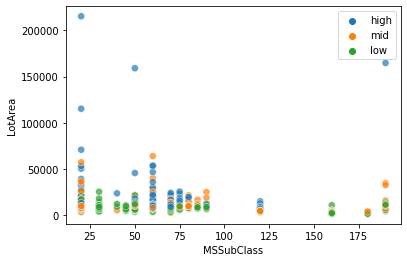

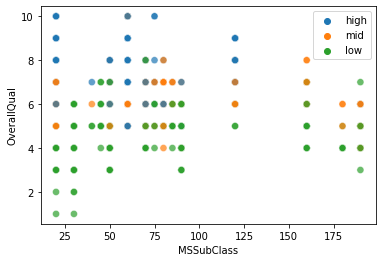

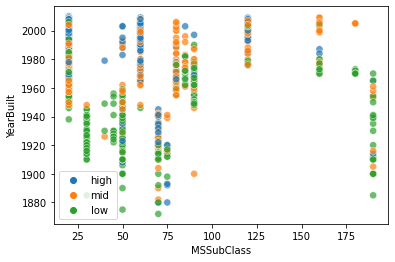

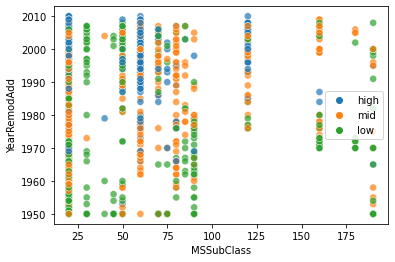

...

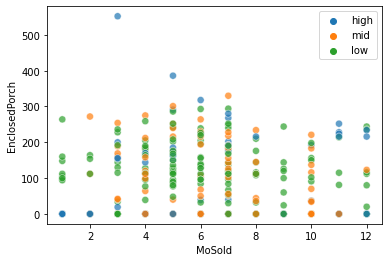

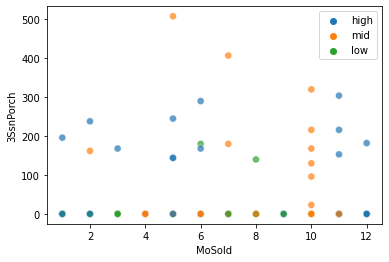

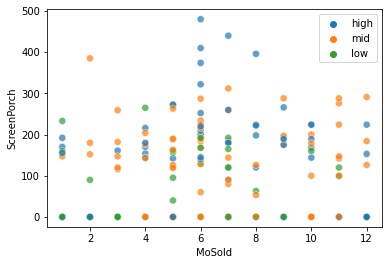

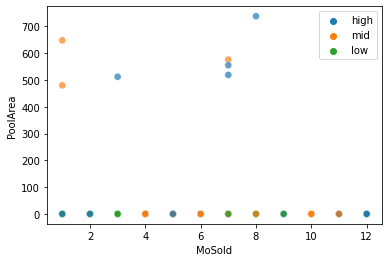

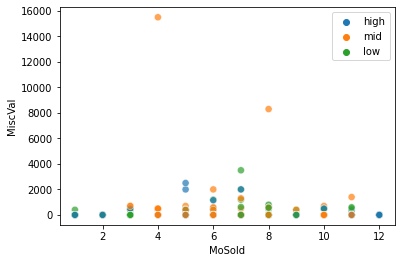

['1stFlrSF',
 '2ndFlrSF',
 '3SsnPorch',
 'BsmtFinSF1',
 'BsmtFinSF2',
 'BsmtUnfSF',
 'EnclosedPorch',
 'GarageArea',
 'GarageYrBlt',
 'GrLivArea',
 'LotArea',
 'LotFrontage',
 'LowQualFinSF',
 'MSSubClass',
 'MasVnrArea',
 'MiscVal',
 'MoSold',
 'OpenPorchSF',
 'OverallQual',
 'PoolArea',
 'ScreenPorch',
 'TotRmsAbvGrd',
 'TotalBsmtSF',
 'WoodDeckSF',
 'YearBuilt',
 'YearRemodAdd']

In [111]:
cat_cols, num_cols, cat_but_car, num_but_cat = grab_col_names(df)

dfx = df.copy()
dfx['SalePrice'] = pd.qcut(dfx['SalePrice'], 3, ['low', 'mid', 'high'])
num_cols = [col for col in num_cols if col not in ["SalePrice", "Id"]]

for i in num_cols:
    for ii in num_cols:
        if i != ii and i:
            sns.scatterplot(x=i, y=ii, data=dfx, hue=dfx['SalePrice'].tolist(), s=50, alpha=0.7)
            plt.show()
            
list(sorted(num_cols))

<h4 class="list-group-item list-group-item-action active" data-toggle="list" role="tab" aria-controls="home">2.2. Correlation Analysis</h4>

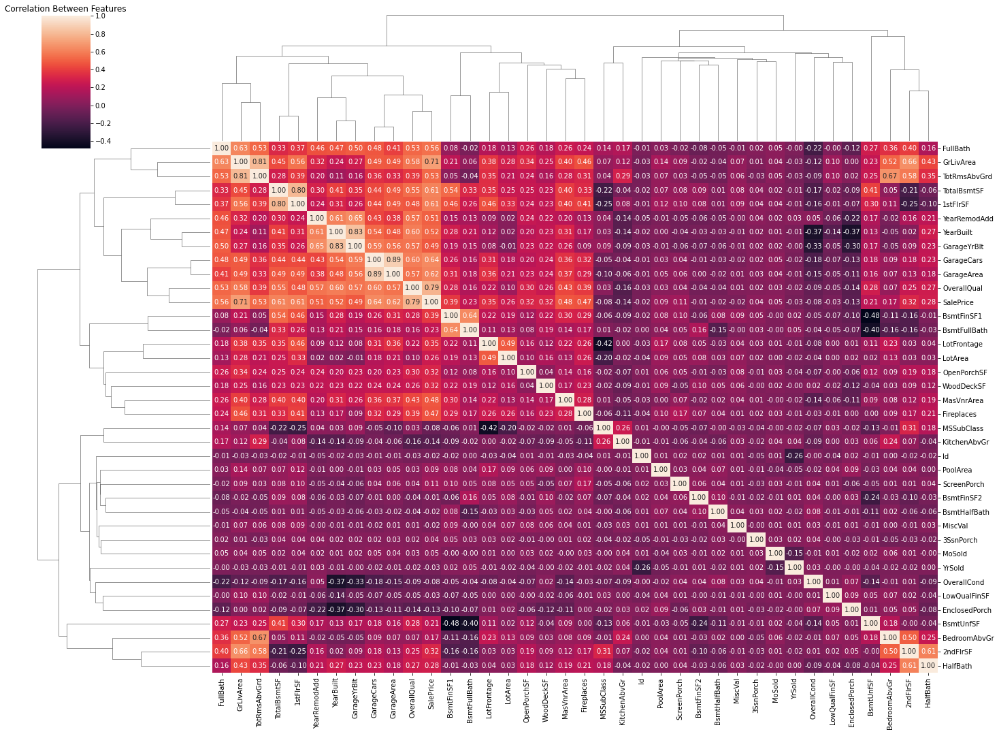

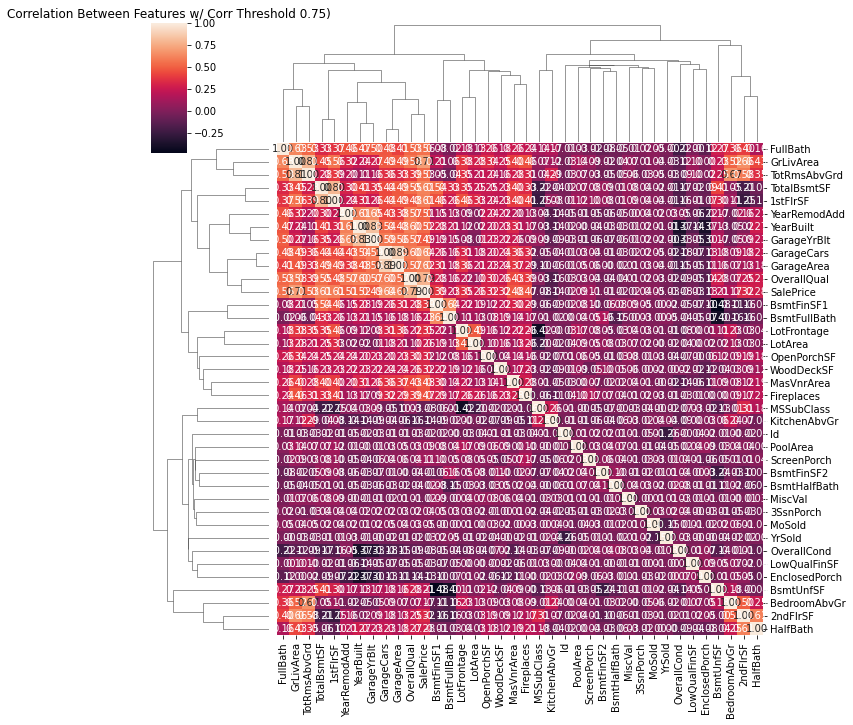

In [112]:
corr_matrix = df.corr()
sns.clustermap(corr_matrix, annot=True, figsize=(20, 15), fmt=".2f")
plt.title("Correlation Between Features")
plt.show()

threshold = 0
filtre = np.abs(corr_matrix["SalePrice"]) > threshold
corr_features = corr_matrix.columns[filtre].tolist()
sns.clustermap(df[corr_features].corr(), annot=True, fmt=".2f")
plt.title("Correlation Between Features w/ Corr Threshold 0.75)")
plt.show()

In [113]:
def find_correlation(dataframe, numeric_cols, corr_limit=0.60):
    
    """
    Correlations of target and independent variables
    
    """
    high_correlations = []
    low_correlations = []
    for col in numeric_cols:
        if col == "SalePrice":
            pass
        else:
            correlation = dataframe[[col, "SalePrice"]].corr().loc[col, "SalePrice"]
            print(col, correlation)
            if abs(correlation) > corr_limit:
                high_correlations.append(col)
            else:
                low_correlations.append(col)
    return low_correlations, high_correlations

In [114]:
num_cols = [col for col in list(set(num_cols + num_but_cat)) if col != "Id"]
low_corrs, high_corrs = find_correlation(df, num_cols)

GarageArea 0.6234314389183598
1stFlrSF 0.6058521846919166
BsmtFinSF2 -0.011378121450215216
LotArea 0.2638433538714063
MiscVal -0.02118957964030379
EnclosedPorch -0.12857795792595636
GarageYrBlt 0.48636167748786213
OverallCond -0.0778558940486776
BsmtFullBath 0.22712223313149718
LotFrontage 0.35179909657067854
BsmtHalfBath -0.016844154297359294
BedroomAbvGr 0.1682131543007415
KitchenAbvGr -0.1359073708421417
BsmtFinSF1 0.38641980624215627
ScreenPorch 0.11144657114291048
BsmtUnfSF 0.214479105546969
YearBuilt 0.5228973328794967
MoSold 0.04643224522381936
GrLivArea 0.7086244776126511
3SsnPorch 0.04458366533574792
YearRemodAdd 0.5071009671113867
GarageCars 0.640409197258349
PoolArea 0.09240354949187278
TotRmsAbvGrd 0.5337231555820238
OpenPorchSF 0.31585622711605577
HalfBath 0.2841076755947784
WoodDeckSF 0.32441344456813076
OverallQual 0.7909816005838047
Fireplaces 0.4669288367515242
FullBath 0.5606637627484452
MSSubClass -0.08428413512659523
MasVnrArea 0.4774930470957107
YrSold -0.028922585

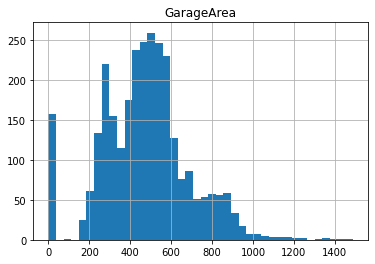

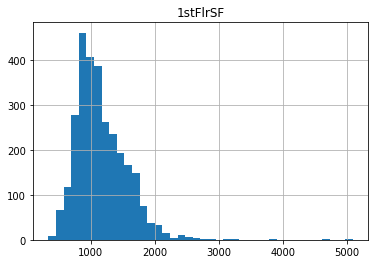

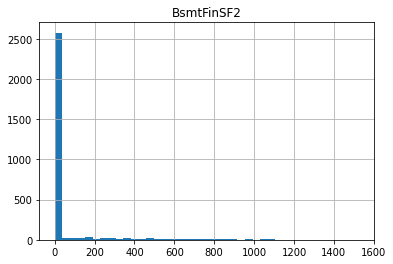

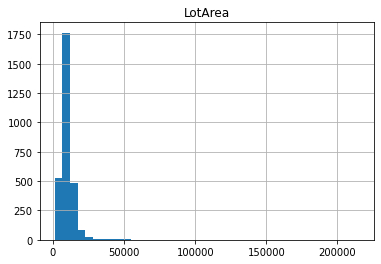

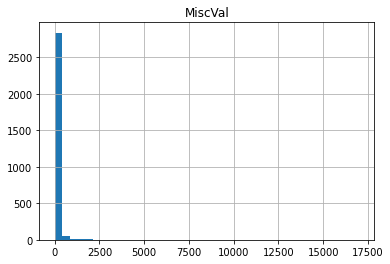

...

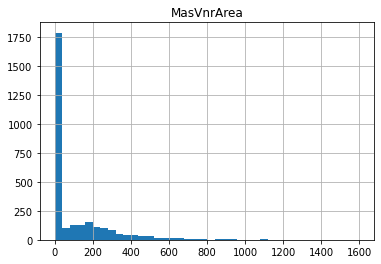

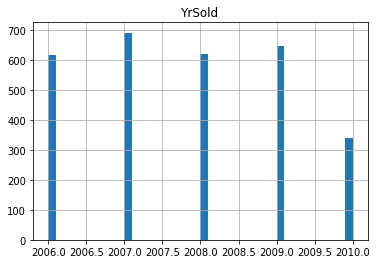

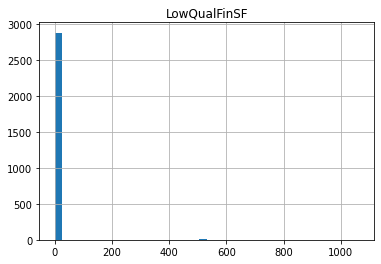

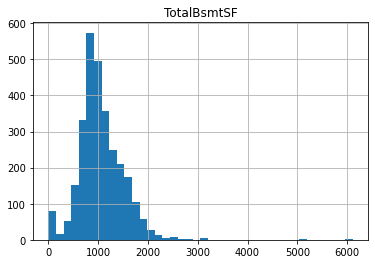

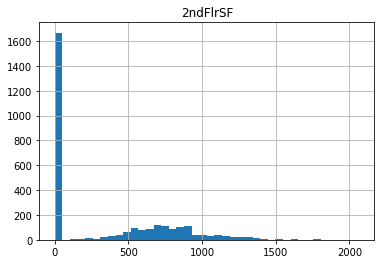

C:\Users\ms\anaconda3\lib\site-packages\pandas\core\series.py:726: RuntimeWarning:

divide by zero encountered in log



ValueError: supplied range of [-inf, 7.756195343948118] is not finite

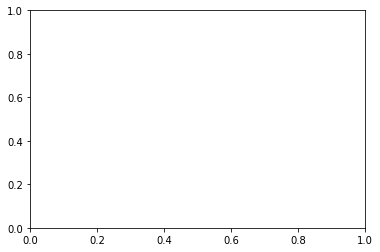

In [115]:
#######################
# Skewed to normal dist trials.
#######################

for col in num_cols:
    df[col].hist(bins=40)
    plt.title(col)
    plt.show()

np.log(df['BsmtUnfSF']).hist(bins=40)
plt.show()
np.log1p(df['BsmtUnfSF']).hist(bins=40)
plt.show()
np.sqrt(df['BsmtUnfSF']).hist(bins=40)
plt.show()
np.power(df['BsmtUnfSF'],2).hist(bins=40)
plt.show()

<h4 class="list-group-item list-group-item-action active" data-toggle="list" role="tab" aria-controls="home">2.3. Producing New Columns for Feature Engineering</h4>

In [116]:
df.loc[:, 'new1'] = 0
df.loc[(df['BsmtFinSF1'] > 1000) & (df['LotFrontage'] > 100), 'new1'] = 1
df.loc[:, 'new2'] = 0
df.loc[(df['OverallQual'] < 5) & (df['MSSubClass'] < 100), 'new2'] = 1
df.loc[:, 'new3'] = 0
df.loc[(df['YearBuilt'] > 1990) & (df['BsmtFinSF1'] > 1000), 'new3'] = 1
df.loc[:, 'new4'] = 0
df.loc[(df['GrLivArea'] > 2000) & (df['LotFrontage'] > 100), 'new4'] = 1

cat_cols, num_cols, cat_but_car, num_but_cat = grab_col_names(df)
df["NEW_POOLQC_BOOL"] = df["PoolQC"].notnull().astype('int')
df.drop("PoolQC", axis=1, inplace=True)
df["NEW_FENCE_BOOL"] = df["Fence"].notnull().astype('int')
df["NEW_FENCE_BOOL"].value_counts(dropna=False)
df.drop("Fence", axis=1, inplace=True)
df["NEW_HOUSE_AGE"] = df["YearBuilt"].apply(lambda x: 2021 - x)
df.drop("YearBuilt", axis=1, inplace=True)
df["NEW_HOUSE_RENO_AGE"] = df["YearRemodAdd"].apply(lambda x: 2021 - x)
df.drop("YearRemodAdd", axis=1, inplace=True)
df["GarageYrBlt"].fillna(0, inplace=True)
df["NEW_GARAGE_AGE"] = df["GarageYrBlt"].apply(lambda x: 2021 - x if x > 0 else (2021 - 1899))
df.drop("GarageYrBlt", axis=1, inplace=True)
df["NEW_ALLEY_BOOL"] = df["Alley"].notnull().astype('int')
df.drop("Alley", axis=1, inplace=True)
df["NEW_MiscFeature_BOOL"] = df["MiscFeature"].notnull().astype('int')
df.drop("MiscFeature", axis=1, inplace=True)

############################################################################################################################

df["N_WholeArea"] = df["GrLivArea"] + df["TotalBsmtSF"] + df["GarageArea"] + df["WoodDeckSF"] + df["OpenPorchSF"] + \
                    df["EnclosedPorch"] + df["3SsnPorch"] + df["ScreenPorch"] + df["PoolArea"]

df["N_GnrlConQual"] = df["OverallQual"] * df["OverallCond"]
df["N_GnrlConQual_Sum"] = df["OverallQual"] + df["OverallCond"]
df["N_TotalPorchDeck"] = df["WoodDeckSF"] + df["OpenPorchSF"] + df["EnclosedPorch"] + df["3SsnPorch"] + df[
    "ScreenPorch"]
df["N_Firepl_Bool"] = df["FireplaceQu"].apply(lambda x: 0 if x == 1 else 1)
df["N_Porch_Bool"] = df["N_TotalPorchDeck"].apply(lambda x: 0 if x == 0 else 1)
df["N_TotalRoomsBaths"] = df["TotRmsAbvGrd"] * 2 + df["FullBath"] * 2 + df["HalfBath"]
df["N_SaleCondNormal_Bool"] = df["SaleCondition"].apply(lambda x: 1 if x == "Normal" else 0)
df.loc[df["MSZoning"].isin(["RM", "RH"]), "MSZoning"] = "RM_RH"
df.loc[df["MSZoning"].isnull(), "MSZoning"] = "RL"
df.loc[df["LotShape"].isin(["IR2", "IR3"]), "LotShape"] = "IR2_IR3"
df.loc[df["LotConfig"].isin(["FR2", "FR3"]), "LotConfig"] = "FR2_3"
df.loc[df["Condition1"].isin(["Artery", "RRAe", "Feedr"]), "Condition1"] = "Artery_Feedr_RRAe"
df.loc[df["Condition1"].isin(["Norm", "RRNe", "RRAn"]), "Condition1"] = "Norm_RRNe_RRAn"
df.loc[df["Condition1"].isin(["PosA", "PosN", "RRNn"]), "Condition1"] = "PosA_PosN_RRNn"

# Condition1 : 9    Being close to the main road or railway
df.loc[df["Condition1"].isin(["Artery", "RRAe", "Feedr"]), "Condition1"] = "Artery_Feedr_RRAe"
df.loc[df["Condition1"].isin(["Norm", "RRNe", "RRAn"]), "Condition1"] = "Norm_RRNe_RRAn"
df.loc[df["Condition1"].isin(["PosA", "PosN", "RRNn"]), "Condition1"] = "PosA_PosN_RRNn"

# Condition2 : 8    Being close to the main road or railway (if there is another way)
df.loc[df["Condition2"].isin(["Artery", "RRAn", "Feedr", "RRNn"]), "Condition2"] = "Artery_Feedr_RRAn_RRNn"
df.loc[df["Condition2"].isin(["RRAe"]), "Condition2"] = "Norm"
df.loc[df["Condition2"].isin(["PosN", "PosA"]), "Condition2"] = "PosN_PosA"

# BldgType : 5    Housing type
df.loc[df["BldgType"].isin(["2fmCon", "Duplex", "Twnhs"]), "BldgType"] = "2fmCon_Duplex_Twnhs"

# HouseStyle : 8    Housing Style
df.loc[df["HouseStyle"].isin(["1.5Unf", "SFoyer"]), "HouseStyle"] = "1.5Unf_SFoyer"
df.loc[df["HouseStyle"].isin(["2Story", "2.5Fin"]), "HouseStyle"] = "2Story_2.5Fin"
df.loc[df["HouseStyle"].isin(["SLvl", "2.5Unf"]), "HouseStyle"] = "SLvl_2.5Unf"

# RoofStyle : 6    Roof type
df.loc[df["RoofStyle"].isin(["Gable", "Gambrel"]), "RoofStyle"] = "Gable_Gambrel"
df.loc[df["RoofStyle"].isin(["Flat", "Mansard", "Shed"]), "RoofStyle"] = "Flat_Mansard_Shed"

# RoofMatl : 8    Roofing material
df.loc[df["RoofMatl"].isin(["WdShake", "WdShngl", "Membran"]), "RoofMatl"] = "WdShake_WdShngl_Membran"
df.loc[df["RoofMatl"].isin(["Tar&Grv", "Metal", "ClyTile", "Roll"]), "RoofMatl"] = "Other"

# Exterior1st : 15
df.loc[
    df["Exterior1st"].isin(["AsbShng", "AsphShn", "CBlock", "BrkComm"]), "Exterior1st"] = "AsbShng_AspShn_CBl_BrkC"
df.loc[df["Exterior1st"].isin(["CemntBd", "ImStucc", "Stone"]), "Exterior1st"] = "CemntBd_ImSt_St"
df["Exterior1st"].fillna("VinylSd", inplace=True)

# Exterior2nd : 16   Exterior cladding in the house (if there is more than one material)
df.loc[df["Exterior2nd"].isin(["Other", "ImStucc", "CmentBd"]), "Exterior2nd"] = "CmentBd_ImStucc_Oth"
df.loc[df["Exterior2nd"].isin(["Brk Cmn", "AsbShng", "CBlock"]), "Exterior2nd"] = "Brk Cmn_AsbShng_CBl"
df.loc[df["Exterior2nd"].isin(["Stucco", "Stone"]), "Exterior2nd"] = "Stucco_Stone"
df.loc[df["Exterior2nd"].isin(["Wd Sdng", "AsphShn"]), "Exterior2nd"] = "Wd Sdng_AsphShn"
df["Exterior2nd"].fillna("VinylSd", inplace=True)

# MasVnrType : 4
df.loc[df["MasVnrType"].isnull(), "MasVnrType"] = "None"
df.loc[df["MasVnrType"].isin(["None", "BrkCmn"]), "MasVnrType"] = "None_BrkCmn"

# Foundation : 6    Institution type
df.loc[df["Foundation"].isin(["Stone", "Wood"]), "Foundation"] = "Stone_Wood"

df["NEW_HasGarage"] = df["GarageType"].apply(lambda x: 0 if x == "None" else 1)
df["NEW_HasBasement"] = df["BsmtQual"].apply(lambda x: 0 if x == "None" else 1)
df["NEW_HasFirePlace"] = df["FireplaceQu"].apply(lambda x: 0 if x == "None" else 1)
df["NEW_Has2ndFloor"] = df["HouseStyle"].apply(lambda x: 1 if "2" in x else 0)
df["NEW_Has_WodDeck"] = df["WoodDeckSF"].apply(lambda x: 0 if x == 0 else 1)
df["NEW_HAS_OPENPorch"] = df["OpenPorchSF"].apply(lambda x: 0 if x == 0 else 1)
df["NEW_HAS_EnclosedPorch"] = df["EnclosedPorch"].apply(lambda x: 0 if x == 0 else 1)
df["NEW_HAS_ScreenPorch"] = df["ScreenPorch"].apply(lambda x: 0 if x == 0 else 1)
df["NEW_OverallGrade"] = df["OverallQual"] * df["OverallCond"]
df['NEW_TotalPorchSF'] = (df['OpenPorchSF'] +
                          df['3SsnPorch'] +
                          df['EnclosedPorch'] +
                          df['ScreenPorch'])
df["NEW_TOTALSF"] = df["1stFlrSF"] + df["2ndFlrSF"] + df["TotalBsmtSF"]
df['NEW_TotalBathrooms'] = (df['FullBath'] +
                            (0.5 * df['HalfBath']) +
                            df['BsmtFullBath'] +
                            (0.5 * df['BsmtHalfBath']))
df["NEW_TotalPorch_SF"] = df["OpenPorchSF"] + df["EnclosedPorch"] + df["3SsnPorch"] + \
                          df["ScreenPorch"]

df["NEW_SqFtPerRoom"] = df["GrLivArea"] / (df["TotRmsAbvGrd"] +
                                           df["FullBath"] +
                                           df["HalfBath"] +
                                           df["KitchenAbvGr"])

df['NEW_Total_Home_Quality'] = df['OverallQual'] + df['OverallCond']

df['NEW_Total_Bathrooms'] = (df['FullBath'] + (0.5 * df['HalfBath']) +
                             df['BsmtFullBath'] + (0.5 * df['BsmtHalfBath']))

df["NEW_HighQualSF"] = df["1stFlrSF"] + df["2ndFlrSF"]

############################################################################################################################
# FEATURE ENGINEERING
############################################################################################################################

# df["MSZoning"].value_counts()
# target_summary_with_cat(df, "SalePrice", "MSZoning")
df.loc[(df["MSZoning"] == "RH"), "MSZoning"] = "RM"

# df["LotShape"].value_counts()
# target_summary_with_cat(df, "SalePrice", "LotShape")
df.loc[(df["LotShape"] == "IR2"), "LotShape"] = "IR1"
df.loc[(df["LotShape"] == "IR3"), "LotShape"] = "IR1"

# df["LotConfig"].value_counts()
# target_summary_with_cat(df, "SalePrice", "LotConfig")
df.loc[(df["LotConfig"] == "Corner"), "LotConfig"] = "FR2"
df.loc[(df["LotConfig"] == "Inside"), "LotConfig"] = "FR2"
df.loc[(df["LotConfig"] == "CulDSac"), "LotConfig"] = "FR3"

#df["LandSlope"].value_counts()
#target_summary_with_cat(df, "SalePrice", "LandSlope")
df.loc[(df["LandSlope"] == "Mod"), "LandSlope"] = "Sev"

#df["Condition1"].value_counts()
#target_summary_with_cat(df, "SalePrice", "Condition1")
df.loc[(df["Condition1"] == "Feedr"), "Condition1"] = "Artery"
df.loc[(df["Condition1"] == "RRAe"), "Condition1"] = "Artery"
df.loc[(df["Condition1"] == "RRAn"), "Condition1"] = "Norm"
df.loc[(df["Condition1"] == "PosN"), "Condition1"] = "PosA"
df.loc[(df["Condition1"] == "RRNe"), "Condition1"] = "PosA"
df.loc[(df["Condition1"] == "RRNn"), "Condition1"] = "PosA"

df.loc[(df["HouseStyle"] == "1.5Fin"), "HouseStyle"] = "1.5Unf"
df.loc[(df["HouseStyle"] == "2.5Unf"), "HouseStyle"] = "1.5Unf"
df.loc[(df["HouseStyle"] == "SFoyer"), "HouseStyle"] = "1.5Unf"
df.loc[(df["HouseStyle"] == "SLvl"), "HouseStyle"] = "1Story"
df.loc[(df["HouseStyle"] == "2.5Fin"), "HouseStyle"] = "2Story"

df.loc[(df["MasVnrType"] == "BrkCmn"), "MasVnrType"] = "None"

#df["GarageType"].value_counts()
#target_summary_with_cat(df, "SalePrice", "GarageType")
df.loc[(df["GarageType"] == "2Types"), "GarageType"] = "Basment"
df.loc[(df["GarageType"] == "CarPort"), "GarageType"] = "Not"



Observations: 2919
Variables: 85
cat_cols: 56
num_cols: 28
cat_but_car: 1
num_but_cat: 14


* Location is an important factor in shaping the price of a home. This is because the location determines the current land price. The location also determines the ease of access to public facilities such as schools, campuses, hospitals and health centers, as well as family leisure facilities such as shopping malls, food tours, and even offers a beautiful view.

<h4 class="list-group-item list-group-item-action active" data-toggle="list" role="tab" aria-controls="home">2.4. Feature Extractions</h4>

In [117]:
# Shows the total number of bathrooms
df["NEW_TotalBath"] = df['BsmtFullBath'] + df['BsmtHalfBath'] * 0.5 + df['FullBath'] + df['HalfBath'] * 0.5

# Total Number of Floors
df['NEW_TotalSF'] = (df['BsmtFinSF1'] + df['BsmtFinSF2'] + df['1stFlrSF'] + df['2ndFlrSF'])

# Square meters of first floor and basement
df["NEW_SF"] = df["1stFlrSF"] + df["TotalBsmtSF"]

# Garage area and sum of square meters
df["NEW_SF_G"] = df["NEW_SF"] + df["GarageArea"]

# Total Patio Area
df['NEW_TotalPorchSF'] = (
        df['OpenPorchSF'] + df['3SsnPorch'] + df['EnclosedPorch'] + df['ScreenPorch'] + df['WoodDeckSF'])

# a variable related to the age and state of the house
# The variable "YearBuilt" must remain in the dataset.

# We divided the age of the house into categories
df["NEW_YEAR_BUILT_CAT"] = pd.qcut(df['NEW_HOUSE_AGE'], 4, labels=[1, 2, 3, 4])
# df['NEW_HOUSE_AGE'].hist(bins=20)
# plt.show()


# total square meters
df["NEW_TOTAL_M^2"] = df["NEW_SF"] + df["2ndFlrSF"]

# Qualities
df["NEW_QUAL_COND"] = df['OverallQual'] + df['OverallCond']

df["NEW_BSMT_QUAL_COND"] = df['BsmtQual'] + df['BsmtCond']

df["NEW_EX_QUAL_COND"] = df['ExterQual'] + df['ExterCond']

df["NEW_QUAL_COND*"] = df['OverallQual'] * df['OverallCond']


# HOUSES WITH POOL
df["NEW_HAS_POOL"] = (df['PoolArea'] > 0).astype('int')

# LUXURIOUS HOUSES
df.loc[(df['Fireplaces'] > 0) & (df['GarageCars'] >= 3), "NEW_LUX"] = 1
df["NEW_LUX"].fillna(0, inplace=True)  # eksiklere 0 verildi.
df["NEW_LUX"] = df["NEW_LUX"].astype(int)

df["NEW_AREA"] = df["GrLivArea"] + df["GarageArea"]
##############################################################################################################


In [118]:
# Ordinal Cols change with points:
ordinal_cols = ['GarageCond', 'GarageQual', 'BsmtQual', 'BsmtCond', 'ExterQual', 'ExterCond', 'HeatingQC',
                'KitchenQual', 'FireplaceQu']
for col in ordinal_cols:
    df[col] = df[col].replace({'Ex': 5, 'Gd': 4, 'TA': 3, 'Fa': 2, 'Po': 1}).fillna(0)

# other Ordinal  cols to change
df['BsmtExposure'] = df['BsmtExposure'].replace({'Ex': 5, 'Gd': 4, 'Av': 3, 'Mn': 2, 'No': 1}).fillna(0)
df['BsmtFinType1'] = df['BsmtFinType1'].replace(
    {'GLQ': 6, 'ALQ': 5, 'BLQ': 4, 'Rec': 3, 'LwQ': 2, 'Unf': 1}).fillna(0)
df['BsmtFinType2'] = df['BsmtFinType2'].replace(
    {'GLQ': 6, 'ALQ': 5, 'BLQ': 4, 'Rec': 3, 'LwQ': 2, 'Unf': 1}).fillna(0)
df['LandSlope'] = df['LandSlope'].replace({'Gtl': 3, 'Mod': 2, 'Sev': 1}).fillna(0)
df['GarageFinish'] = df['GarageFinish'].replace({'Fin': 3, 'RFn': 2, 'Unf': 1}).fillna(0)

# i dont want these cols to be threaded as cat cols at grab cols part. i will remove them.
ordinal_cols = ['GarageCond', 'GarageQual', 'BsmtQual', 'BsmtCond', 'ExterQual', 'ExterCond', 'HeatingQC',
                'KitchenQual', 'FireplaceQu'
    , 'BsmtExposure', 'BsmtFinType1', 'BsmtFinType2', 'LandSlope', 'GarageFinish'
    , 'OverallCond', 'BedroomAbvGr', 'GarageCars']


<h4 class="list-group-item list-group-item-action active" data-toggle="list" role="tab" aria-controls="home">2.5. Outliers</h4>

In [119]:
def replace_with_thresholds(dataframe, variable, q1=0.25, q3=0.75):
    low_limit, up_limit = outlier_thresholds(dataframe, variable, q1=q1, q3=q3)
    dataframe.loc[(dataframe[variable] < low_limit), variable] = low_limit
    dataframe.loc[(dataframe[variable] > up_limit), variable] = up_limit

In [120]:
def outlier_thresholds(dataframe, col_name, q1=0.25, q3=0.75):
    quartile1 = dataframe[col_name].quantile(q1)
    quartile3 = dataframe[col_name].quantile(q3)
    interquantile_range = quartile3 - quartile1
    up_limit = quartile3 + 1.5 * interquantile_range
    low_limit = quartile1 - 1.5 * interquantile_range
    return low_limit, up_limit

In [121]:
# Change outliers to low and up limits.

cat_cols, num_cols, cat_but_car, num_but_cat = grab_col_names(df, excluded=ordinal_cols)

num_cols.remove('SalePrice')
for col in num_cols:
    replace_with_thresholds(df, col, q1=0.15, q3=0.85)

Observations: 2919
Variables: 123
cat_cols: 55
num_cols: 50
cat_but_car: 1
num_but_cat: 29


<h4 class="list-group-item list-group-item-action active" data-toggle="list" role="tab" aria-controls="home">2.6. Missing Values</h4>

In [122]:
cat_cols, num_cols, cat_but_car, num_but_cat = grab_col_names(df)
df["GarageType"].fillna('NO_GARAGE', inplace=True)
df["MasVnrType"].fillna('NO_Masonry', inplace=True)
df["MasVnrArea"].fillna('NO_Masonry', inplace=True)
df['LotFrontage'].fillna(df['LotArea'] / 170,
                         inplace=True)  # there is around 1/170 between 2 columns so filled with it.

df.isnull().sum().sum()
df.apply(lambda x: x.fillna(x.mode()[0], inplace=True) if (x.dtype == "O" and len(x.unique()) <= 10) else x,
         axis=0)  # col type is int interestingly.
df = df.apply(lambda x: x.fillna(x.mode()[0]) if (x.dtype == "O" and len(x.unique()) <= 10) else x, axis=0)
df.isnull().sum().sum()
df['Electrical'].dtype == "O"
len(df['Electrical'].unique()) <= 10
df['Electrical'].mode()[0]

df['Electrical'].isnull().sum()
df['Electrical'].value_counts(dropna=False)

df["Electrical"].fillna('SBrkr', inplace=True)
df['SaleType'].fillna('WD', inplace=True)
df['GarageCars'].fillna(2, inplace=True)
df['Functional'].fillna('Typ', inplace=True)
df['BsmtHalfBath'].fillna(0.000, inplace=True)
df['BsmtFullBath'].fillna(0.000, inplace=True)
df['BsmtFinSF2'].fillna(0.000, inplace=True)
df['Exterior1st'].fillna('VinylSd', inplace=True)
df['Exterior2nd'].fillna('VinylSd', inplace=True)
df['Utilities'].fillna('AllPub', inplace=True)
df['MSZoning'].fillna('RL', inplace=True)
df['GarageArea'].fillna(0, inplace=True)
df['TotalBsmtSF'].fillna(29.500, inplace=True)
df['BsmtUnfSF'].fillna(0, inplace=True)
df['BsmtFinSF1'].fillna(0, inplace=True)

cat_cols, num_cols, cat_but_car, num_but_cat = grab_col_names(df, excluded=ordinal_cols)
na_cols_cat = [col for col in cat_cols if df[col].isnull().sum() > 0 and "SalePrice" not in col]
df[na_cols_cat] = df[na_cols_cat].apply(lambda x: x.fillna(x.mode()), axis=0)

na_cols_num = [col for col in num_cols if df[col].isnull().sum() > 0 and "SalePrice" not in col]
df[na_cols_num] = df[na_cols_num].apply(lambda x: x.fillna(x.median()), axis=0)



Observations: 2919
Variables: 123
cat_cols: 78
num_cols: 44
cat_but_car: 1
num_but_cat: 52
Observations: 2919
Variables: 123
cat_cols: 61
num_cols: 43
cat_but_car: 2
num_but_cat: 35


<h4 class="list-group-item list-group-item-action active" data-toggle="list" role="tab" aria-controls="home">2.7. Label Encoding</h4>

In [123]:
def label_encoder(dataframe, binary_col):
    labelencoder = LabelEncoder()
    dataframe[binary_col] = labelencoder.fit_transform(dataframe[binary_col])
    return dataframe

In [124]:
binary_cols = [col for col in df.columns if df[col].dtype not in [int, float] and df[col].nunique() == 2]

for col in binary_cols:
    label_encoder(df, col)



<h4 class="list-group-item list-group-item-action active" data-toggle="list" role="tab" aria-controls="home">2.8. Rare Encoding</h4>

In [125]:
def rare_analyser(dataframe, target, cat_cols):
    for col in cat_cols:
        print(col, ":", len(dataframe[col].value_counts()))
        print(pd.DataFrame({"COUNT": dataframe[col].value_counts(),
                            "RATIO": dataframe[col].value_counts() / len(dataframe),
                            "TARGET_MEAN": dataframe.groupby(col)[target].mean()}), end="\n\n\n")


def rare_encoder(dataframe, rare_perc):
    temp_df = dataframe.copy()

    rare_columns = [col for col in temp_df.columns if temp_df[col].dtypes == 'O'
                    and (temp_df[col].value_counts() / len(temp_df) < rare_perc).any(axis=None)]

    for var in rare_columns:
        tmp = temp_df[var].value_counts() / len(temp_df)
        rare_labels = tmp[tmp < rare_perc].index
        temp_df[var] = np.where(temp_df[var].isin(rare_labels), 'Rare', temp_df[var])

    return temp_df

In [126]:
cat_cols, num_cols, cat_but_car, num_but_cat = grab_col_names(df, excluded=ordinal_cols)
df = rare_encoder(df, 0.01)

Observations: 2919
Variables: 123
cat_cols: 61
num_cols: 43
cat_but_car: 2
num_but_cat: 38


<h4 class="list-group-item list-group-item-action active" data-toggle="list" role="tab" aria-controls="home">2.9. One-Hot Encoding</h4>

In [127]:
def one_hot_encoder(dataframe, categorical_cols, drop_first=False):
    dataframe = pd.get_dummies(dataframe, columns=categorical_cols, drop_first=drop_first)
    return dataframe

In [128]:
# on some columns, I don't want to apply one-hot encoder...

additional_exceptions = ['Street', 'Utilities', 'BsmtFinSF2', 'CentralAir', 'LowQualFinSF', 'BsmtFullBath',
                         'BsmtHalfBath', 'FullBath', 'HalfBath', 'KitchenAbvGr', 'Fireplaces', '3SsnPorch',
                         'ScreenPorch', 'PoolArea', 'MiscVal', 'YrSold', 'NEW_POOLQC_BOOL', 'NEW_FENCE_BOOL',
                         'NEW_ALLEY_BOOL', 'NEW_MiscFeature_BOOL']

ordinal_cols = ['GarageCond', 'GarageQual', 'BsmtQual', 'BsmtCond', 'ExterQual', 'ExterCond', 'HeatingQC',
                'KitchenQual', 'FireplaceQu'
    , 'BsmtExposure', 'BsmtFinType1', 'BsmtFinType2', 'LandSlope', 'GarageFinish'
    , 'OverallCond', 'BedroomAbvGr', 'GarageCars']

excluded_list = []
excluded_list.extend(ordinal_cols)
excluded_list.extend(additional_exceptions)
cat_cols, num_cols, cat_but_car, num_but_cat = grab_col_names(df, excluded=excluded_list)
cat_cols = cat_cols + cat_but_car



df = pd.get_dummies(df, drop_first=1)
# df = one_hot_encoder(df, cat_cols)
cat_cols, num_cols, cat_but_car, num_but_cat = grab_col_names(df, excluded=excluded_list)

useless_cols = [col for col in df.columns if df[col].nunique() == 2 and
                (df[col].value_counts() / len(df) < 0.01).any(axis=None)]

df.drop(useless_cols, axis=1, inplace=True)



Observations: 2919
Variables: 123
cat_cols: 42
num_cols: 43
cat_but_car: 1
num_but_cat: 18
Observations: 2919
Variables: 204
cat_cols: 124
num_cols: 43
cat_but_car: 0
num_but_cat: 124


<h1 class="list-group-item list-group-item-action active" data-toggle="list" role="tab" aria-controls="home">3. Machine Learning Model</h1>

* In this study machine learning algorithms were applied against each other in order to investigate which one is more successful in predicting housing prices. 

<h4 class="list-group-item list-group-item-action active" data-toggle="list" role="tab" aria-controls="home">3.1. Standart Scaler</h4>

In [129]:
num_cols = [col for col in num_cols if "Id" not in col]
num_cols = [col for col in num_cols if "SalePrice" not in col]
scaler = StandardScaler()
df[num_cols] = scaler.fit_transform(df[num_cols])


<h4 class="list-group-item list-group-item-action active" data-toggle="list" role="tab" aria-controls="home">3.2. Modeling</h4>

In [130]:
global train_df, test_df
train_df = df[df['SalePrice'].notnull()]
test_df = df[df['SalePrice'].isnull()].drop("SalePrice", axis=1)

global X, y
# y = train_df["SalePrice"]
y = np.log1p(train_df['SalePrice'])  # to increase train speed.
X = train_df.drop(["Id", "SalePrice"], axis=1)

<h4 class="list-group-item list-group-item-action active" data-toggle="list" role="tab" aria-controls="home">3.3. Hyper Parameters Tunning</h4>

In [131]:
def run_single_model():
    models = [('LR', LinearRegression()),
              ("Ridge", Ridge()),
              ("Lasso", Lasso()),
              ("ElasticNet", ElasticNet()),
              ('KNN', KNeighborsRegressor()),
              ('CART', DecisionTreeRegressor()),
              ('RF', RandomForestRegressor()),
              ('SVR', SVR()),
              ('GBM', GradientBoostingRegressor()),
              ("XGBoost", XGBRegressor(objective='reg:squarederror')),
              ("LightGBM", LGBMRegressor()),
              ("CatBoost", CatBoostRegressor(verbose=False))
        , ("AdaBoost", AdaBoostRegressor())
        , ("Bagging", BaggingRegressor())
        , ("ExtraTrees", ExtraTreesRegressor())
        , ("HistGradient", HistGradientBoostingRegressor())
              ]

    global output_df
    output_df = pd.DataFrame(models, columns=["MODEL_NAME", "MODEL_BASE"])
    output_df.drop('MODEL_BASE', axis=1, inplace=True)
    for name, regressor in models:
        rmse_cv = np.mean(np.sqrt(-cross_val_score(regressor, X, y, cv=10, scoring="neg_mean_squared_error")))
        print(f"RMSE: {round(rmse_cv, 4)} ({name}) ")
        output_df.loc[output_df['MODEL_NAME'] == name, "RMSE_BASE_CV_ALL"] = rmse_cv
        
    rf_params = {"max_depth": [5, 15, 20, None],
                 "max_features": [5, 7, 9, "auto"],
                 "min_samples_split": [6, 8, 15],
                 "n_estimators": [150, 200, 300]}

    xgboost_params = {"learning_rate": [0.01, 0.05, 0.1, 0.15],
                      "max_depth": [3, 5, 8],
                      "n_estimators": [100, 200, 300],
                      "colsample_bytree": [0.3, 0.5, 0.8]}

    lightgbm_params = {"learning_rate": [0.001, 0.01, 0.1],
                       "n_estimators": [100, 300, 500],
                       "colsample_bytree": [0.1, 0.3, 0.7, 1],
                       #"num_leaves": [5,31],
                       #"max_bin": [55, 255],
                       #"bagging_fraction": [0.8, 1.0],
                       #"bagging_freq": [0, 5],
                       #"feature_fraction": [0.2319, 1.0],
                       #"feature_fraction_seed": [2, 9],
                       #"bagging_seed": [3, 9],
                       #"min_data_in_leaf": [6, 20],
                       #"min_sum_hessian_in_leaf": [0.003, 11]
                       }

    extraTrees_params = {
        'n_estimators': [10, 50, 100],
        'max_depth': [2, 16, 50],
        'min_samples_split': [2, 6],
        'min_samples_leaf': [1, 2],
        'max_features': ['auto', 'sqrt', 'log2'],
        'bootstrap': [True, False],
        'warm_start': [True, False],
    }

    HistGradient_params = {"learning_rate": [0.01, 0.05],
                           "max_iter": [20, 100],
                           "max_depth": [None, 25],
                           "l2_regularization": [0.0, 1.5],
                           }

    catboost_params = {"iterations": [ 200, 500, 1000],
                       "learning_rate": [ 0.01, 0.1, 0.3],
                       "depth": [3, 6]}
    regressors = [
        ("RF", RandomForestRegressor(), rf_params),
        ('XGBoost', XGBRegressor(objective='reg:squarederror'), xgboost_params),
        ('LightGBM', LGBMRegressor(), lightgbm_params),
        ('CatBoost', CatBoostRegressor(verbose=False), catboost_params),
        ('ExtraTrees', ExtraTreesRegressor(), extraTrees_params),
        ('HistGradient', HistGradientBoostingRegressor(), HistGradient_params),

    ]
    global best_models
    best_models = {}

    for name, regressor, params in regressors:
        # GridSearch
        gs_best = GridSearchCV(regressor, params, cv=3, n_jobs=-1, verbose=False).fit(X, y)
        final_model = regressor.set_params(**gs_best.best_params_)
        rmse = np.mean(np.sqrt(-cross_val_score(final_model, X, y, cv=10, scoring="neg_mean_squared_error")))
        print(f"RMSE (After): {round(rmse, 4)} ({name}) ")
        output_df.loc[output_df['MODEL_NAME'] == name, "RMSE_TUNED_CV_ALL"] = rmse
        print(f"{name} best params: {gs_best.best_params_}", end="\n\n")
        output_df.loc[output_df['MODEL_NAME'] == name, "BEST_PARAMS"] = str(gs_best.best_params_)

        best_models[name] = final_model

In [132]:
def run_multiple_model():
    
    """
    Stacking & Ensemble Learning
    
    """
    
    best_models

    model_name = 'voting_reg_XG_Cat'
    model = VotingRegressor(estimators=[('XGBoost', best_models["XGBoost"]), ('CatBoost', best_models["CatBoost"])])
    model.fit(X, y)
    rmse = np.mean(np.sqrt(-cross_val_score(model, X, y, cv=10, scoring="neg_mean_squared_error")))
    print(f"RMSE ({model_name}): {round(rmse, 4)} ")
    global output_df
    output_df = output_df.append({'MODEL_NAME': {model_name}}, ignore_index=True)
    output_df.loc[output_df['MODEL_NAME'] == {model_name}, "RMSE_TUNED_CV_ALL"] = rmse
    best_models[model_name] = model

    model_name = 'stacking_reg_XG_Cat'
    estimators = [('XGBoost', best_models["XGBoost"]), ('CatBoost', best_models["CatBoost"])]
    model = StackingRegressor(estimators=estimators, final_estimator=best_models["XGBoost"])
    model.fit(X, y)
    rmse = np.mean(np.sqrt(-cross_val_score(model, X, y, cv=10, scoring="neg_mean_squared_error")))
    print(f"RMSE ({model_name}): {round(rmse, 4)} ")
    output_df = output_df.append({'MODEL_NAME': {model_name}}, ignore_index=True)
    output_df.loc[output_df['MODEL_NAME'] == {model_name}, "RMSE_TUNED_CV_ALL"] = rmse
    best_models[model_name] = model

    model_name = 'voting_reg_RF_LGBM'
    model = VotingRegressor(estimators=[('RF', best_models["RF"]), ('LightGBM', best_models["LightGBM"])])
    model.fit(X, y)
    rmse = np.mean(np.sqrt(-cross_val_score(model, X, y, cv=10, scoring="neg_mean_squared_error")))
    print(f"RMSE ({model_name}): {round(rmse, 4)} ")
    output_df = output_df.append({'MODEL_NAME': {model_name}}, ignore_index=True)
    output_df.loc[output_df['MODEL_NAME'] == {model_name}, "RMSE_TUNED_CV_ALL"] = rmse
    best_models[model_name] = model

    estimators = [('RF', best_models["RF"]), ('XGBoost', best_models["XGBoost"])]
    stacking_reg = StackingRegressor(estimators=estimators, final_estimator=best_models["LightGBM"])
    stacking_reg.fit(X, y)
    stacking_reg_rmse = np.mean(np.sqrt(-cross_val_score(stacking_reg, X, y, cv=10, scoring="neg_mean_squared_error")))
    print(f"RMSE (stacking_reg_RF_XG): {round(stacking_reg_rmse, 4)} ")
    output_df = output_df.append({'MODEL_NAME': "stacking_reg_rmse"}, ignore_index=True)
    output_df.loc[output_df['MODEL_NAME'] == "stacking_reg_rmse", "RMSE_TUNED_CV_ALL"] = stacking_reg_rmse
    best_models['stacking_reg_RF_XG'] = stacking_reg

    voting_reg_RF_XG_LGBM = VotingRegressor(estimators=[('RF', best_models["RF"]), ('XGBoost', best_models["XGBoost"]),
                                                        ('LightGBM', best_models["LightGBM"])])
    voting_reg_RF_XG_LGBM.fit(X, y)
    voting_reg_rmse = np.mean(np.sqrt(-cross_val_score(voting_reg_RF_XG_LGBM, X, y, cv=10, scoring="neg_mean_squared_error")))
    print(f"RMSE (voting_reg_RF_XG_LGBM): {round(voting_reg_rmse, 4)} ")
    output_df = output_df.append({'MODEL_NAME': "voting_reg_RF_XG_LGBM"}, ignore_index=True)
    output_df.loc[output_df['MODEL_NAME'] == "voting_reg_RF_XG_LGBM", "RMSE_TUNED_CV_ALL"] = voting_reg_rmse
    best_models['voting_reg_RF_XG_LGBM'] = voting_reg_RF_XG_LGBM


    voting_reg_RF_XG_LGBM_Cat = VotingRegressor(estimators=[('RF', best_models["RF"]), ('XGBoost', best_models["XGBoost"]),
                                                        ('LightGBM', best_models["LightGBM"]), ('CatBoost', best_models["CatBoost"])])
    voting_reg_RF_XG_LGBM_Cat.fit(X, y)
    voting_reg_rmse = np.mean(np.sqrt(-cross_val_score(voting_reg_RF_XG_LGBM_Cat, X, y, cv=10, scoring="neg_mean_squared_error")))
    print(f"RMSE (voting_reg_RF_XG_LGBM): {round(voting_reg_rmse, 4)} ")
    output_df = output_df.append({'MODEL_NAME': "voting_reg_RF_XG_LGBM_Cat"}, ignore_index=True)
    output_df.loc[output_df['MODEL_NAME'] == "voting_reg_RF_XG_LGBM_Cat", "RMSE_TUNED_CV_ALL"] = voting_reg_rmse
    best_models['voting_reg_RF_XG_LGBM_Cat'] = voting_reg_RF_XG_LGBM_Cat

In [133]:
def run_selected_cols(model, thr=1):
    feature_imp = pd.DataFrame({'Value': model.feature_importances_, 'Feature': X.columns})
    feature_imp[feature_imp["Value"] > 0].shape
    feature_imp[feature_imp["Value"] > 1].shape
    feature_imp[feature_imp["Value"] < 1].shape
    zero_imp_cols = feature_imp[feature_imp["Value"] < thr]["Feature"].values
    global selected_cols
    selected_cols = [col for col in X.columns if col not in zero_imp_cols]

    global model_selected_cols
    model_selected_cols = LGBMRegressor(random_state=1)
    rmse_cv = np.mean(
        np.sqrt(-cross_val_score(model_selected_cols, X[selected_cols], y, cv=10, scoring="neg_mean_squared_error")))
    print(f"RMSE: {round(rmse_cv, 4)} ({model_selected_cols}) ")

In [134]:
def plot_importance(model, features, num=20, save=False):
    feature_imp = pd.DataFrame({'Value': model.feature_importances_, 'Feature': features.columns})
    plt.figure(figsize=(10, 10))
    sns.set(font_scale=1)
    sns.barplot(x="Value", y="Feature", data=feature_imp.sort_values(by="Value",
                                                                     ascending=False)[0:num])
    plt.title('Features')
    plt.tight_layout()
    plt.show()
    if save:
        plt.savefig('importances.png')

In [135]:
def create_submission(final_model):
    
    """
    Uploading Results
    
    """
   
    submission_df = pd.DataFrame()
    submission_df['Id'] = test_df["Id"]
    y_pred_sub = final_model.predict(test_df.drop("Id", axis=1))
    y_pred_sub = np.expm1(y_pred_sub)
    submission_df['SalePrice'] = y_pred_sub
    submission_df['Id'] = submission_df['Id'].astype('int')
    submission_df.to_csv('submission.csv', index=False)

In [142]:
run_single_model()

RMSE: 0.1439 (LR) 
RMSE: 0.1275 (Ridge) 
RMSE: 0.3986 (Lasso) 
RMSE: 0.3986 (ElasticNet) 
RMSE: 0.1465 (KNN) 
RMSE: 0.194 (CART) 
RMSE: 0.1343 (RF) 
RMSE: 0.3903 (SVR) 
RMSE: 0.1227 (GBM) 
RMSE: 0.1338 (XGBoost) 
RMSE: 0.127 (LightGBM) 
RMSE: 0.1178 (CatBoost) 
RMSE: 0.1676 (AdaBoost) 
RMSE: 0.1398 (Bagging) 
RMSE: 0.1296 (ExtraTrees) 
RMSE: 0.1291 (HistGradient) 
RMSE (After): 0.1311 (RF) 
RF best params: {'max_depth': 15, 'max_features': 9, 'min_samples_split': 6, 'n_estimators': 150}

RMSE (After): 0.1211 (XGBoost) 
XGBoost best params: {'colsample_bytree': 0.8, 'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 200}

RMSE (After): 0.1241 (LightGBM) 
LightGBM best params: {'colsample_bytree': 0.3, 'learning_rate': 0.01, 'n_estimators': 500}

RMSE (After): 0.119 (CatBoost) 
CatBoost best params: {'depth': 3, 'iterations': 500, 'learning_rate': 0.1}

RMSE (After): 0.1296 (ExtraTrees) 
ExtraTrees best params: {'bootstrap': False, 'max_depth': 50, 'max_features': 'auto', 'min_samples

C:\Users\ms\anaconda3\lib\site-packages\joblib\externals\loky\process_executor.py:691: UserWarning:

A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.



RMSE (After): 0.1279 (HistGradient) 
HistGradient best params: {'l2_regularization': 1.5, 'learning_rate': 0.05, 'max_depth': None, 'max_iter': 100}



In [143]:
run_multiple_model()

RMSE (voting_reg_XG_Cat): 0.1173 
RMSE (stacking_reg_XG_Cat): 0.1302 
RMSE (voting_reg_RF_LGBM): 0.1257 
RMSE (stacking_reg_RF_XG): 0.1334 
RMSE (voting_reg_RF_XG_LGBM): 0.1207 
RMSE (voting_reg_RF_XG_LGBM): 0.1188 


In [144]:
output_df.sort_values(['RMSE_TUNED_CV_ALL','RMSE_BASE_CV_ALL'])

,MODEL_NAME,RMSE_BASE_CV_ALL,RMSE_TUNED_CV_ALL,BEST_PARAMS
16,{voting_reg_XG_Cat},nan,0.1173,NaN
21,voting_reg_RF_XG_LGBM_Cat,nan,0.1188,NaN
11,CatBoost,0.1178,0.1190,"{'depth': 3, 'iterations': 500, 'learning_rate': 0.1}"
20,voting_reg_RF_XG_LGBM,nan,0.1207,NaN
9,XGBoost,0.1338,0.1211,"{'colsample_bytree': 0.8, 'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 200}"
10,LightGBM,0.1270,0.1241,"{'colsample_bytree': 0.3, 'learning_rate': 0.01, 'n_estimators': 500}"
18,{voting_reg_RF_LGBM},nan,0.1257,NaN
15,HistGradient,0.1291,0.1279,"{'l2_regularization': 1.5, 'learning_rate': 0.05, 'max_depth': None, 'max_iter': 100}"
14,ExtraTrees,0.1296,0.1296,"{'bootstrap': False, 'max_depth': 50, 'max_features': 'auto', 'min_samples_leaf': 1, 'min_sample..."
17,{stacking_reg_XG_Cat},nan,0.1302,NaN


In [145]:
best_models

{'RF': RandomForestRegressor(max_depth=15, max_features=9, min_samples_split=6,
                       n_estimators=150),
 'XGBoost': XGBRegressor(base_score=None, booster=None, colsample_bylevel=None,
              colsample_bynode=None, colsample_bytree=0.8, gamma=None,
              gpu_id=None, importance_type='gain', interaction_constraints=None,
              learning_rate=0.1, max_delta_step=None, max_depth=3,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              n_estimators=200, n_jobs=None, num_parallel_tree=None,
              random_state=None, reg_alpha=None, reg_lambda=None,
              scale_pos_weight=None, subsample=None, tree_method=None,
              validate_parameters=None, verbosity=None),
 'LightGBM': LGBMRegressor(colsample_bytree=0.3, learning_rate=0.01, n_estimators=500),
 'CatBoost': <catboost.core.CatBoostRegressor at 0x1d8c61549c8>,
 'ExtraTrees': ExtraTreesRegressor(max_depth=50, min_samples_split=6, warm_start=True)

In [146]:
final_model1 = best_models['voting_reg_XG_Cat'].fit(X, y)

In [147]:
create_submission(final_model1)

<h1 class="list-group-item list-group-item-action active" data-toggle="list" role="tab" aria-controls="home">4. Conclusions</h1>

* In this dataset, I have tried to minimize the rmse of the house prices. As usual we start with EDA. Tried to add new features to identify the data to models in a better way. I have tried so many different model from sklearn, ligthgbm, catboost, xgboost and as well as ngboost. On top of it, I have applied Voting and Stacking Models to improve the model predictions.

<h1 class="list-group-item list-group-item-action active" data-toggle="list" role="tab" aria-controls="home">5. References</h1>

* [[1] Chen, X., Wei, L. and Xu, J., 2017. House price prediction using LSTM. arXiv preprint arXiv:1709.08432.](#0)
* [[2] Engström, I. and Ihre, A., 2019. Predicting house prices with machine learning methods.](#0)
* [[3] Ho, W.K., Tang, B.S. and Wong, S.W., 2021. Predicting property prices with machine learning algorithms. Journal of Property Research, 38(1), pp.48-70.](#0)
* [[4] Alfiyatin, A.N., Febrita, R.E., Taufiq, H. and Mahmudy, W.F., 2017. Modeling house price prediction using regression analysis and particle swarm optimization. International Journal of Advanced Computer Science and Applications, 8(10), pp.323-326.](#0)
* [[5] Truong, Q., Nguyen, M., Dang, H. and Mei, B., 2020. Housing price prediction via improved machine learning techniques. Procedia Computer Science, 174, pp.433-442.](#0)


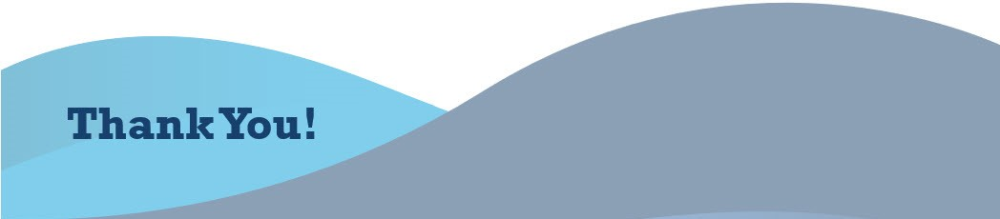